# longyearbyen_test

In [148]:
%load_ext autoreload
%autoreload 2
#import os
#import sys
#module_path = os.path.abspath(os.path.join('..'))
#if module_path not in sys.path:
#    sys.path.append(module_path)
#import oogeso
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO
#print("Using Oogeso version {}".format(oogeso.__version__))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Read input data

In [149]:
first = pd.read_csv('../tests/test_data/LYR_load.csv')
second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
assert isinstance(first, pd.DataFrame)

merged = pd.merge(first, second, how='left', on='timestamp')
merged = pd.merge(merged, third, how='left', on='timestamp')
merged = pd.merge(merged, fourth, how='left', on='timestamp')
merged.fillna(0,inplace=True)
#merged.to_csv('../tests/test_data/profiles_merged.csv', index=False)

In [150]:
#merged.set_index(merged["timestamp"], inplace=True)
merged

,timestamp,el_load,heat_load,V47,V105,local_time,PV,geothermal
0,2017-01-01 00:00:00,4.81,7.466778,0.456943,0.397433,2017-01-01 01:00:00,0.0,1.0
1,2017-01-01 01:00:00,4.33,7.551868,0.672022,0.633202,2017-01-01 02:00:00,0.0,1.0
2,2017-01-01 02:00:00,4.54,7.573140,0.633713,0.590261,2017-01-01 03:00:00,0.0,1.0
3,2017-01-01 03:00:00,4.69,7.573140,0.974162,1.000000,2017-01-01 04:00:00,0.0,1.0
4,2017-01-01 04:00:00,4.30,7.573140,0.804349,0.814672,2017-01-01 05:00:00,0.0,1.0
...,...,...,...,...,...,...,...,...
17515,2018-12-31 19:00:00,5.26,10.139872,0.029887,0.033634,2018-12-31 20:00:00,0.0,1.0
17516,2018-12-31 20:00:00,5.16,9.826704,0.019165,0.019081,2018-12-31 21:00:00,0.0,1.0
17517,2018-12-31 21:00:00,5.12,9.640496,0.000000,0.000166,2018-12-31 22:00:00,0.0,1.0
17518,2018-12-31 22:00:00,4.99,9.513536,0.035914,0.030137,2018-12-31 23:00:00,0.0,1.0


In [151]:
#case="_diesel_only"
#case="_diesel_battery"
#case="_ir_offshore_pv_geo"
#case="_ir_offshore_pv_geo_diesel"
#case="_br_onshore_pv_geo_diesel"
case="_br_onshore_pv_geo_diesel_2018"
timerange=[0,24*365] #one year (with 1 hour timestep)
#timerange=[0,24*7*50] #50 weeks (with 1 hour timestep)
#timerange=[0,24*7] #one week (with 1 hour timestep)

outpath = "result/"
plots.plotter="plotly"

data = file_io.read_data_from_yaml("../tests/test_data/longyearbyen_test.yaml")
data.parameters.co2_tax = 2 # NOK/kgCO2 Political goal towards 2030

incl_battery=False
incl_geothermal=False
incl_wind=False
incl_pv=False
incl_hydrogen=False
incl_diesel=False

NOK_per_euro = 10

diesel_investment_cost = 0 # Already installed
diesel_fixed_op_cost = 8800/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
diesel_op_cost = 6/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs
diesel_fuel_cost = 7590

onshore_wind_investment_cost = 1.04*10**6 * NOK_per_euro # M€/MW * 10**6 * NOK/€ = NOK/MW
onshore_wind_fixed_op_cost = 12600/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
onshore_wind_op_cost = 1.35/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs

offshore_wind_investment_cost = 1.93*10**6 * NOK_per_euro # M€/MW * 10**6 * NOK/€ = NOK/MW
offshore_wind_fixed_op_cost = 36053/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
offshore_wind_op_cost = 2.7/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs

pv_investment_cost = 0.57*10**6 * NOK_per_euro # M€/MW * 10**6 * NOK/€ = NOK/MW
pv_fixed_op_cost = 8900/(3600*24*365) * NOK_per_euro # €/(MW*year) / 365*24*3600 s/year * NOK/€ => NOK/(MW)
pv_op_cost = 0/3600 * NOK_per_euro # €/MWh / 3600 s/h * NOK/€ => NOK/MWs

if case=="_diesel_only":
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    incl_diesel=True
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery":
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    incl_battery=True
    incl_diesel=True
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_ir_offshore_pv_geo":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    geothermal_P_max=1.3 # Wintertime power input
    geothermal_profile="geothermal"
    incl_battery=True
    incl_geothermal=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost


elif case=="_ir_offshore_pv_geo_diesel":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_profile="geothermal"
    incl_battery=True
    incl_geothermal=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    incl_diesel=True
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost

elif case=="_br_onshore_pv_geo_diesel_2018":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged = pd.merge(merged, fourth, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    wind_P_max=3.45*10 # MW, 10 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    pv_P_max=25 # MWp, Sun on all roofs
    pv_profile="PV" # Sun profile
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_profile="geothermal"
    incl_battery=True
    incl_geothermal=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    incl_diesel=True
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

winddevices = ["wind", "wind_farm", "el_wf_ps"]
pvdevices = ["pv", "el_pv_ps"]
batterydevices = ["el_storage"]
powersupplydevices = ["powersupply", "el_ps_load", "heat_ps_load"]
geothermaldevices = ["geothermal", "el_ps_geo", "heat_geo_load"]
hydrogendevices = ['electrolyser','fuelcell','h2_storage','el_ps_h2','heat_h2_load']
dieselgenerators = ['backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3']
dieselheaters = ['diesel_boiler_1','diesel_boiler_2','boiler_houses']
dieseldevices = dieselgenerators + dieselheaters + ['diesel_source', 'el_diesel_load', 'heat_diesel_load', 'diesel_backup']
diesel_source = "diesel_source"
for dev in data.devices:
    if dev.id in winddevices:
        dev.include = incl_wind
        if incl_wind:
            dev.flow_max = wind_P_max
            dev.flow_min = dev.flow_max
            dev.profile = wind_profile
            dev.investment_cost = wind_investment_cost
            dev.fixed_op_cost = wind_fixed_op_cost
            dev.op_cost = wind_op_cost
    if dev.id in pvdevices:
        dev.include = incl_pv
        if incl_pv:
            dev.flow_max = pv_P_max
            dev.flow_min = dev.flow_max
            dev.profile = pv_profile
            dev.investment_cost = pv_investment_cost
            dev.fixed_op_cost = pv_fixed_op_cost
            dev.op_cost = pv_op_cost
    if dev.id in batterydevices:
        dev.include = incl_battery
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
    if dev.id in geothermaldevices:
        dev.include = incl_geothermal
        if incl_geothermal:
            dev.flow_max = geothermal_P_max
            dev.flow_min = 0
            dev.profile = geothermal_profile
    if dev.id in dieseldevices:
        dev.include = incl_diesel
        if dev.id in dieselgenerators:
            dev.investment_cost = diesel_investment_cost
            dev.fixed_op_cost = diesel_fixed_op_cost
            dev.op_cost = diesel_op_cost
        if dev.id == diesel_source:
            dev.op_cost = diesel_fuel_cost
for edge in data.edges:
    if edge.id in winddevices:
        edge.include = incl_wind
    if edge.id in powersupplydevices:
        edge.include = incl_wind or incl_battery or incl_pv or incl_geothermal or incl_hydrogen
    if edge.id in geothermaldevices:
        edge.include = incl_geothermal
    if edge.id in hydrogendevices:
        edge.include = incl_hydrogen
    if edge.id in dieseldevices:
        edge.include = incl_diesel
for node in data.nodes:
    if node.id in winddevices:
        node.include = incl_wind
    if node.id in pvdevices:
        node.include = incl_pv
    if node.id in powersupplydevices:
        node.include = incl_wind or incl_pv or incl_battery or incl_geothermal or incl_hydrogen
    if node.id in geothermaldevices:
        node.include = incl_geothermal
    if node.id in hydrogendevices:
        node.include = incl_hydrogen
    if node.id in dieseldevices:
        node.include = incl_diesel

simulator = oogeso.Simulator(data)

In [152]:
for dev in data.devices:
    #if dev.id=='el_load':
    print(dev)

id='wind' node_id='wind_farm' name='wind_farm' include=True profile='V105' flow_min=34.5 flow_max=34.5 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=1 op_cost=0.00375 fixed_op_cost=0.003995433789954338 investment_cost=10400000.0 penalty_function=None model=<ModelType.SOURCE_EL: 'sourceel'> co2em=0.0
id='pv' node_id='pv' name='pv' include=True profile='PV' flow_min=25 flow_max=25 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=1 op_cost=0.0 fixed_op_cost=0.002822171486555048 investment_cost=5700000.0 penalty_function=None model=<ModelType.SOURCE_EL: 'sourceel'> co2em=0.0
id='loadshed' node_id='powersupply' name='Loadshedding (dummy)' include=False profile=None flow_min=None flow_max=1000.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=0.0 op_cost=10.0 fixed_op_cost=None investment_cost=None penalty_function=None model=<ModelType.SOURCE_EL: 'sourceel'> co2em=0.0
id='el_load' node_id='load' name='general el load' include=True pr

In [153]:
# Test solve:
simulator.optimiser.solve(solver="gurobi")

{'Problem': [{'Name': 'x150742', 'Lower bound': 3.3028916666666324, 'Upper bound': 3.3028916666666603, 'Number of objectives': 1, 'Number of constraints': 47739, 'Number of variables': 34802, 'Number of binary variables': 8880, 'Number of integer variables': 8880, 'Number of continuous variables': 25922, 'Number of nonzeros': 98223, 'Sense': 'minimize'}], 'Solver': [{'Status': 'ok', 'Return code': '0', 'Message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Termination condition': 'optimal', 'Termination message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Wall time': '0.6131572723388672', 'Error rc': 0, 'Time': 1.794471263885498}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

In [154]:
#simulator.optimiser.constr_diesel_source_flowMin.pprint()

In [155]:
simulator.optimiser.paramDeviceEnergyInitially.pprint()

paramDeviceEnergyInitially : Size=21, Index=setDevice, Domain=Reals, Default=None, Mutable=True
    Key             : Value
      backup_east_1 :         0
      backup_east_2 :         0
      backup_east_3 :         0
      backup_west_1 :         0
      backup_west_2 :         0
      backup_west_3 :         0
      boiler_houses :         0
    diesel_boiler_1 :         0
    diesel_boiler_2 :         0
      diesel_source :         0
            el_dump :         0
            el_load :         0
         el_storage :       3.0
       electrolyser :         0
           fuelcell :         0
         geothermal :         0
         h2_storage : 1500000.0
          heat_dump :         0
          heat_load :         0
                 pv :         0
               wind :         0


In [156]:
simulator.optimiser.dual.pprint()

dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
    Key : Value


In [157]:
simulator.optimiser.paramProfiles.pprint() # all 1 before update, from profile after
simulator.optimiser.paramDeviceIsOnInitially.pprint() # all 1 before and after update
simulator.optimiser.paramDevicePrepTimestepsInitially.pprint() # all 0 before and after update
simulator.optimiser.paramDevicePowerInitially.pprint() # unchanged before/after

paramProfiles : Size=1200, Index=paramProfiles_index, Domain=Reals, Default=None, Mutable=True
    Key                 : Value
              ('PV', 0) :     1
              ('PV', 1) :     1
              ('PV', 2) :     1
              ('PV', 3) :     1
              ('PV', 4) :     1
              ('PV', 5) :     1
              ('PV', 6) :     1
              ('PV', 7) :     1
              ('PV', 8) :     1
              ('PV', 9) :     1
             ('PV', 10) :     1
             ('PV', 11) :     1
             ('PV', 12) :     1
             ('PV', 13) :     1
             ('PV', 14) :     1
             ('PV', 15) :     1
             ('PV', 16) :     1
             ('PV', 17) :     1
             ('PV', 18) :     1
             ('PV', 19) :     1
             ('PV', 20) :     1
             ('PV', 21) :     1
             ('PV', 22) :     1
             ('PV', 23) :     1
             ('PV', 24) :     1
             ('PV', 25) :     1
             ('PV', 26) :     1
         

### Inspect input data

In [158]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(data.dict()[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [159]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [160]:
for e in data.edges: print(e.id,e.bidirectional)

el_wf_ps True
el_pv_ps True
el_ps_load True
heat_h2_load True
el_ps_h2 True
el_ps_geo True
heat_geo_load True
el_diesel_load True
heat_diesel_load True


0 2016


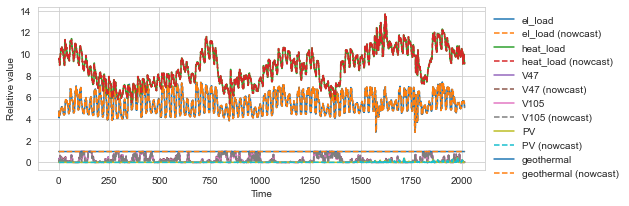

In [161]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,3))
ax=plt.gca()
#day 6, hour 22: 6*24*12 + 22*12 = 
#tstart=7*24*12
#tlen=12*12
#xvalues = pd.date_range(start="00:00:00",freq="5min",periods=tlen)
#myFmt = mdates.DateFormatter('%H:%M')
#ax.xaxis.set_major_formatter(myFmt)
tstart=0
tlen=7*24*12
xvalues=range(tstart,tstart+tlen)
print(tstart,tlen)
for pr in profiles:
    if pr.id in ["curve_const","waterinj","h2target"]: continue
    color = next(ax._get_lines.prop_cycler)['color']
    plt.step(xvalues,pr.data[tstart:(tstart+tlen)],label=pr.id,color=color,where="post")
    if pr.data_nowcast is not None:
        color = next(ax._get_lines.prop_cycler)['color']
        plt.step(xvalues,pr.data_nowcast[tstart:(tstart+tlen)],"--",
                 label="{} (nowcast)".format(pr.id),color=color,where="post")        
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
plt.xlabel("Time")
plt.ylabel("Relative value")
plt.savefig(outpath+"timerseries_ts{}_{}.pdf".format(tstart,case),dpi=300,bbox_inches="tight")

In [162]:
outpath

'result/'

In [163]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
#fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

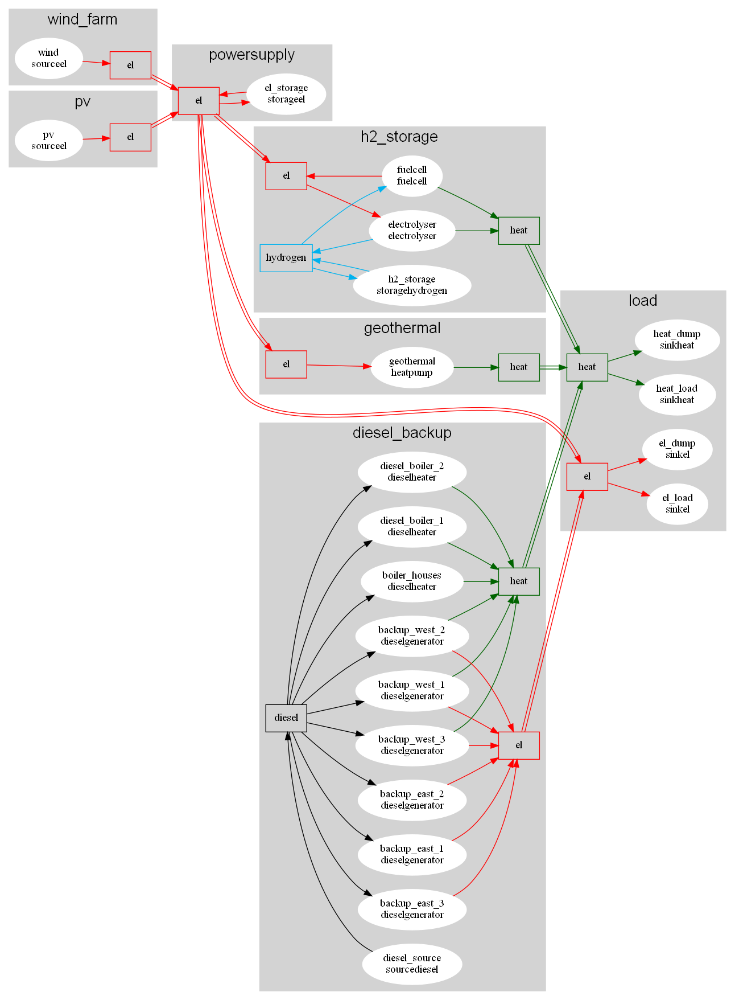

In [164]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
#dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))
# 

### Some checks on input data

In [165]:
if incl_geothermal:
    print(simulator.optimiser.all_edges['heat_geo_load'].edge_data)

id='heat_geo_load' node_from='geothermal' node_to='load' length_km=None flow_max=None investment_cost=None bidirectional=True include=True carrier=<CarrierType.HEAT: 'heat'> power_loss_function=None


## Solve

If the problem is infeasible, try 
* relaxing pressure deviation limits (generic value and per-node value)
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/water/gas has a place to go


In [166]:
if incl_wind:
    dev_d=simulator.optimiser.all_devices["wind"].dev_data
if incl_wind or incl_pv or incl_battery or incl_geothermal or incl_hydrogen:
    node_d=simulator.optimiser.all_nodes["powersupply"].node_data

In [167]:
#simulator.optimiser.write("testplatform.mps")
sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=15)
print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))

100%|██████████| 355/355 [2:03:17<00:00, 20.84s/it]

Mean CO2 emission rate      = 0.2 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [99]:
#simulator.optimiser.updateOptimisationModel(timestep=0,profiles=data.profiles,first=True)
simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

('test.mps', 1522132263040)

In [100]:
# Remove negligible dump values (Less than 1 W)
sim_result.device_flow["el_dump"]["el"]["in"][abs(sim_result.device_flow["el_dump"]["el"]["in"]) < 10**(-6)] = 0
sim_result.device_flow["heat_dump"]["heat"]["in"][abs(sim_result.device_flow["heat_dump"]["heat"]["in"]) < 10**(-6)] = 0
sim_result.op_cost_per_dev["el_dump"][sim_result.device_flow["el_dump"]["el"]["in"] == 0] = 0
sim_result.op_cost_per_dev["heat_dump"][sim_result.device_flow["heat_dump"]["el"]["in"] == 0] = 0

In [101]:
#simulator.optimiser.constrO_elReserveMargin[6].pprint()
#pyo.value(simulator.optimiser.varEdgeFlow["el_ps_load",10])

In [102]:
# print(pyo.value(simulator.optimiser.paramProfiles["V105",1]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["wind",6]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["electrolyser",6]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["geothermal",6]),
# )

In [103]:
sim_result.op_cost_per_dev.backup_east_1

time
0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8515    0.0
8516    0.0
8517    0.0
8518    0.0
8519    0.0
Length: 8520, dtype: object

## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [104]:
pickle_save='{}case{}.pkl'.format(outpath,case)
# Save (pickle) - for later opening and analysis
dumpdata={"data":data,"result":sim_result}
with open(pickle_save, mode='wb') as file:
   pickle.dump(dumpdata, file)
print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_br_onshore_pv_geo_diesel_2018.pkl


In [105]:
# #Open previously saved object (including simulation results)
# pickle_save='{}case{}.pkl'.format(outpath,case)
# with open(pickle_save, mode='rb') as file:
#   sim_data = pickle.load(file)
# data=sim_data["data"]
# sim_result=sim_data["result"]
# simulator.result_object = sim_result

## Analyse results

In [106]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel")#, windturbines=['wind'])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi

,_br_onshore_pv_geo_diesel_2018
hours_simulated,8.520000e+03
kgCO2_per_year,2.391126e+06
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,9.057296e+02
elconsumption_mwh_per_year,1.201513e+05
elconsumption_avg_mw,1.371590e+01
gt_starts_per_year,8.328169e+01
gt_stops_per_year,8.328169e+01
gt_hoursrunning_per_year,1.722183e+03
wind_output_mwh_per_year,0.000000e+00


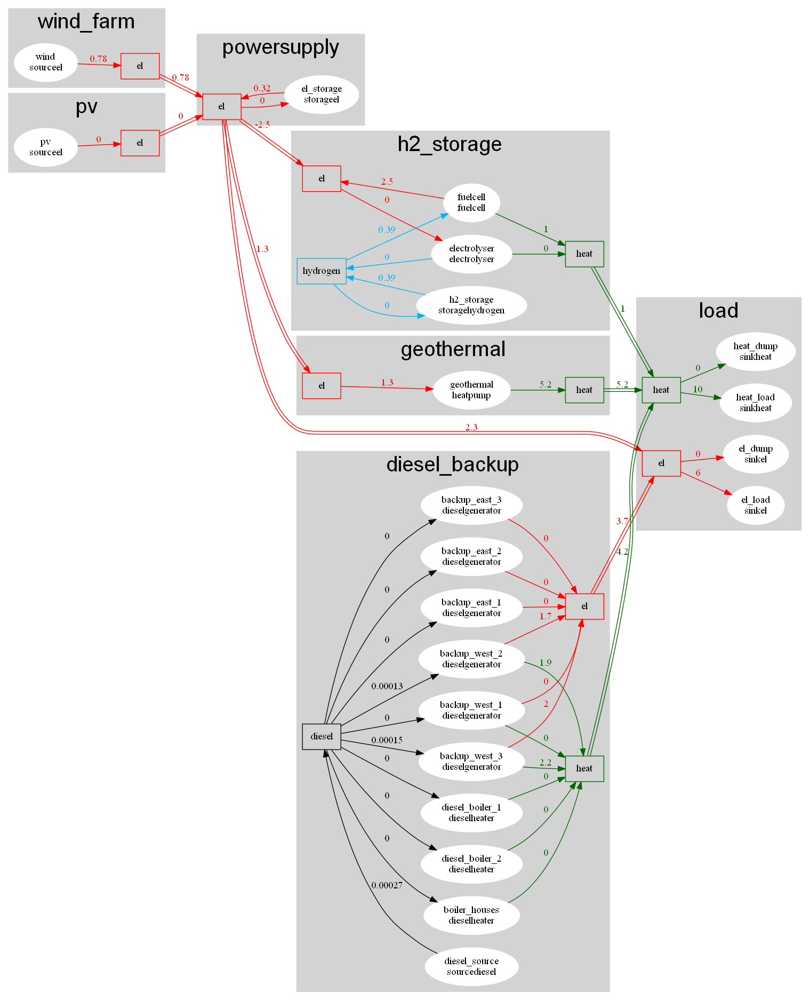

In [170]:
tstep=1750
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [108]:
print(sim_result.device_flow.el_load.el["in"].to_string())

time
0       4.73000
1       4.12000
2       4.46000
3       4.38000
4       4.43000
5       4.38000
6       4.51500
7       4.57500
8       4.75500
9       4.75500
10      4.96333
11      4.96333
12      4.96333
13      5.01000
14      5.13000
15      5.10000
16      5.06500
17      5.06500
18      4.97000
19      4.93000
20      4.88000
21      4.76000
22      4.66000
23      4.47000
24      4.52000
25      4.38000
26      4.40000
27      4.40000
28      4.42000
29      4.51000
30      4.52000
31      5.00000
32      5.53800
33      5.64000
34      5.78000
35      5.75500
36      5.75500
37      5.73000
38      5.58500
39      5.54900
40      5.65700
41      5.63000
42      5.45000
43      5.40000
44      5.25000
45      5.22000
46      5.40000
47      4.96000
48      4.64000
49      4.50000
50      4.64333
51      4.50333
52      4.65333
53      4.74000
54      4.74000
55      5.38000
56      6.08000
57      6.79000
58      6.76000
59      6.76000
60      6.56000
61      6.70000
62 

In [109]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.000000
                    1       0.000000
                    2       0.000000
                    3       0.000000
                    4       0.000000
                    5       0.000000
                    6       0.000000
                    7       0.000000
                    8       0.000000
                    9       0.000000
                    10      0.000000
                    11      0.000000
                    12      0.000000
                    13      0.000000
                    14      0.000000
                    15      0.000000
                    16      0.000000
                    17      0.000000
                    18      0.000000
                    19      0.000000
                    20      0.000000
                    21      0.000000
                    22      0.000000
                    23      0.000000
                    24      0.000000
                    25      0.000000
             

In [110]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
#simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
#print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
#print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

In [111]:
combine = None
if incl_diesel: combine = [["diesel_generators"],[dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el",filename=None,devs_combine=combine,exclude_zero=True)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputel_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [112]:
combine = None
if incl_diesel: combine = [["diesel_boilers"],[dieselheaters]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="heat",filename=None,devs_combine=combine,exclude_zero=True)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputheat_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [113]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator","source_el"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(case))
fig.show()

,el,heat
device,,
backup_east_1,0.000000,0.000000e+00
backup_east_2,0.000000,0.000000e+00
backup_east_3,0.000000,0.000000e+00
backup_west_1,0.000000,0.000000e+00
backup_west_2,0.000000,0.000000e+00
backup_west_3,0.000000,0.000000e+00
boiler_houses,0.000000,0.000000e+00
diesel_boiler_1,0.000000,0.000000e+00
diesel_boiler_2,0.000000,0.000000e+00


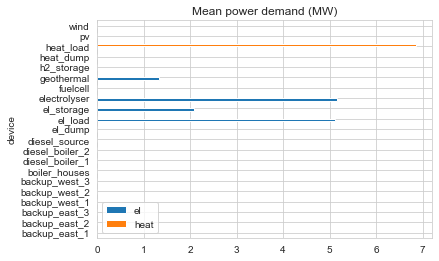

In [114]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [115]:
energydemand.sum()

el      13.715899
heat     6.855699
dtype: float64

In [116]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in           0.000029
          out          0.000029
el        in          13.715899
          out         13.715899
heat      in           6.855699
          out          6.855699
hydrogen  in           0.544544
          out          0.544544
dtype: float64
Mean flow per device:


carrier            diesel                  el                    heat  \
terminal               in       out        in       out            in   
device                                                                  
backup_east_1    0.000000  0.000000  0.000000  0.000000  0.000000e+00   
backup_east_2    0.000000  0.000000  0.000000  0.000000  0.000000e+00   
backup_east_3    0.000000  0.000000  0.000000  0.000000  0.000000e+00   
backup_west_1    0.000009  0.000000  0.000000  0.116438  0.000000e+00   
backup_west_2    0.000010  0.000000  0.000000  0.142142  0.000000e+00   
backup_west_3    0.000010  0.000000  0.000000  0.132744  0.000000e+00   
boiler_houses    0.000000  0.000000  0.000000  0.000000  0.000000e+00   
diesel_boiler_1  0.000000  0.000000  0.000000  0.000000  0.000000e+00   
diesel_boiler_2  0.000000  0.000000  0.000000  0.000000  0.000000e+00   
diesel_source    0.000000  0.000029  0.000000  0.000000  0.000000e+00   
el_dump          0.000000  0.000000  0.004524  0.000000  0.000000e+00   
el_load          0.000000  0.000000  5.121251  0.000000  0.000000e+00   
el_storage       0.000000  0.000000  2.092516  1.888152  0.000000e+00   
electrolyser     0.000000  0.000000  5.160768  0.000000  0.000000e+00   
fuelcell         0.000000  0.000000  0.000000  1.888087  0.000000e+00   
geothermal       0.000000  0.000000  1.336840  0.000000  0.000000e+00   
h2_storage       0.000000  0.000000  0.000000  0.000000  0.000000e+00   
heat_dump        0.000000  0.000000  0.000000  0.000000  4.915665e-07   
heat_load        0.000000  0.000000  0.000000  0.000000  6.855699e+00   
pv               0.000000  0.000000  0.000000  1.841265  0.000000e+00   
wind             0.000000  0.000000  0.000000  7.707072  0.000000e+00   

carrier                    hydrogen            
terminal              out        in       out  
device                                         
backup_east_1    0.000000  0.000000  0.000000  
backup_east_2    0.000000  0.000000  0.000000  
backup_east_3    0.000000  0.000000  0.000000  
backup_west_1    0.130076  0.000000  0.000000  
backup_west_2    0.158797  0.000000  0.000000  
backup_west_3    0.148393  0.000000  0.000000  
boiler_houses    0.000000  0.000000  0.000000  
diesel_boiler_1  0.000000  0.000000  0.000000  
diesel_boiler_2  0.000000  0.000000  0.000000  
diesel_source    0.000000  0.000000  0.000000  
el_dump          0.000000  0.000000  0.000000  
el_load          0.000000  0.000000  0.000000  
el_storage       0.000000  0.000000  0.000000  
electrolyser     0.315839  0.000000  0.254069  
fuelcell         0.755235  0.290475  0.000000  
geothermal       5.347360  0.000000  0.000000  
h2_storage       0.000000  0.254069  0.290475  
heat_dump        0.000000  0.000000  0.000000  
heat_load        0.000000  0.000000  0.000000  
pv               0.000000  0.000000  0.000000  
wind             0.000000  0.000000  0.000000

In [117]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [118]:
df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8510, 8511, 8512, 8513, 8514, 8515, 8516, 8517, 8518, 8519],
           dtype='int64', name='time', length=8520)

In [119]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
if incl_wind:
    fig.add_scatter(
                    x=df.index,
                    y=df["wind"],
                    line_shape="hv",
                    name="wind",
                    #line=dict(color=colour[k]),
                    stackgroup="P",
                    legendgroup="wind",
                    row=1,
                    col=1,
                )

In [120]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    if incl_wind: dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    if incl_geothermal: dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['geothermal',t].value
    if incl_hydrogen: 
        dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
        dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [121]:
if incl_wind:
    fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [122]:
"""
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)
"""

'\ndf=sim_result.device_flow.unstack([0,1,2])[[(\'ex_g\',\'gas\',\'in\'),(\'ex_o\',\'oil\',\'in\')]]\ndf.columns=[\'gas\',\'oil\']\ndf=df.reset_index()\ndf["gas"]=df["gas"]/1000 # convert to oil equivalents\ndf = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=(\'time\'))\npx.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()\n\nplots.plot_export_revenue(sim_result)\n'

In [123]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   21 : {'wind', 'pv', 'el_load', 'heat_load', 'electrolyser', 'fuelcell', 'h2_storage', 'el_storage', 'geothermal', 'heat_dump', 'el_dump', 'diesel_source', 'backup_east_1', 'backup_east_2', 'backup_east_3', 'backup_west_1', 'backup_west_2', 'backup_west_3', 'diesel_boiler_1', 'diesel_boiler_2', 'boiler_houses'}


In [124]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',
                                 filename=None)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [125]:
plots.plotter="plotly"
if 'h2_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'h2_storage',
                                 filename=None)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [126]:
if incl_hydrogen: simulator.optimiser.all_devices["h2_storage"].dev_data.model

In [127]:
plots.plotter="plotly"
fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt.png")#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [128]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]

fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [129]:
fig = plots.plot_CO2_rate(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [130]:
fig=plots.plot_CO2_intensity(sim_result,filename=outpath+"co2intensity_opt.png")
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [131]:
fig = plots.plot_op_cost(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [132]:
plots.plotter="plotly"
combine = None

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [133]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [173]:
fig = plots.plot_all_costs(sim_result, simulator.optimiser)
fig.show()

In [174]:
fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True)
fig.show()

18766568.880368147


In [175]:
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]
fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True, device_combine=combine)
fig.show()

18766568.880368147


In [137]:
plots.plotter="plotly"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False)
#plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
#plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [138]:
plots.plotter="plotly"
combine = [["diesel_generators"],[dieselgenerators]]

fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,device_combine=combine)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [139]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [140]:
if incl_hydrogen:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
    fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
    fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
    fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
    fig.show()
    fig.write_image(outpath+"h2_storage_{}.pdf".format(case))

In [141]:
simulator.optimiser.all_devices

{'wind': <oogeso.core.devices.source.SourceEl at 0x1625c4ef850>,
 'pv': <oogeso.core.devices.source.SourceEl at 0x1625c4ee200>,
 'el_load': <oogeso.core.devices.sink.SinkEl at 0x1625c4ef6d0>,
 'heat_load': <oogeso.core.devices.sink.SinkHeat at 0x1625c4ef790>,
 'electrolyser': <oogeso.core.devices.electrolyser.Electrolyser at 0x1625c4ef6a0>,
 'fuelcell': <oogeso.core.devices.fuelcell.FuelCell at 0x1625c4effd0>,
 'h2_storage': <oogeso.core.devices.storage.StorageHydrogen at 0x1625c4efe20>,
 'el_storage': <oogeso.core.devices.storage.StorageEl at 0x1625c4efbb0>,
 'geothermal': <oogeso.core.devices.heatpump.HeatPump at 0x1625c4efe80>,
 'heat_dump': <oogeso.core.devices.sink.SinkHeat at 0x1625c4ef940>,
 'el_dump': <oogeso.core.devices.sink.SinkEl at 0x1625c4efb80>,
 'diesel_source': <oogeso.core.devices.source.SourceDiesel at 0x1625c4ef820>,
 'backup_east_1': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x1625c4ef8e0>,
 'backup_east_2': <oogeso.core.devices.dieselgenerator.Diesel

In [142]:
sim_result.el_backup.unstack("device")

device,backup_east_1,backup_east_2,backup_east_3,backup_west_1,backup_west_2,backup_west_3,el_storage,fuelcell,pv,wind
time,,,,,,,,,,
0,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,0.000000,45.000000,45.000000
1,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,45.000000,0.000000,45.000000,45.000000
2,43.649155,43.649155,43.649155,43.649155,43.649155,43.649155,43.649155,0.000000,43.649155,43.649155
3,41.308625,41.308625,41.308625,41.308625,41.308625,41.308625,41.308625,0.000000,41.308625,41.308625
4,51.333507,51.333507,51.333507,51.333507,51.333507,51.333507,51.333507,6.333507,51.333507,51.333507
...,...,...,...,...,...,...,...,...,...,...
8515,72.033185,72.033185,72.033185,72.033185,72.033185,72.033185,72.033185,27.033185,72.033185,72.033185
8516,64.000425,64.000425,64.000425,64.000425,64.000425,64.000425,64.000425,19.000425,64.000425,64.000425
8517,49.700576,49.700576,49.700576,49.700576,49.700576,49.700576,49.700576,4.700576,49.700576,49.700576


In [143]:
simulator.optimiser